1- Data Exploration with Pandas

In [20]:
import pandas as pd 
# Load the Dataset 
data = pd.read_csv('C:/Users/ABL/Downloads/diabetes (1).csv')
data.head ()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1


In [21]:
# Display a concise summary of the dataset
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 768 entries, 0 to 767
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Pregnancies               768 non-null    int64  
 1   Glucose                   768 non-null    int64  
 2   BloodPressure             768 non-null    int64  
 3   SkinThickness             768 non-null    int64  
 4   Insulin                   768 non-null    int64  
 5   BMI                       768 non-null    float64
 6   DiabetesPedigreeFunction  768 non-null    float64
 7   Age                       768 non-null    int64  
 8   Outcome                   768 non-null    int64  
dtypes: float64(2), int64(7)
memory usage: 54.1 KB


In [22]:
# General info:

# Get the shape of the dataset (number of rows and columns):
# 1/
data.shape

(768, 9)

In [23]:
# 2/ with a message 
rows, columns = data.shape
print(f"The Dataset contains {rows} rows and {columns} columns.")

The Dataset contains 768 rows and 9 columns.


In [24]:
# Display the column names
data.columns
# 1/Print all column names in a single line
print(f"The columns are: {list(data.columns)}.")

The columns are: ['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin', 'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome'].


In [25]:
# 2/Print each column name on a separate line for better readability
print("The columns are:")
for col in data.columns:
    print(col)

The columns are:
Pregnancies
Glucose
BloodPressure
SkinThickness
Insulin
BMI
DiabetesPedigreeFunction
Age
Outcome


In [26]:
# Display the data types of each column
data.dtypes

Pregnancies                   int64
Glucose                       int64
BloodPressure                 int64
SkinThickness                 int64
Insulin                       int64
BMI                         float64
DiabetesPedigreeFunction    float64
Age                           int64
Outcome                       int64
dtype: object

In [27]:
# Print the data types of each column
print ("The data types of the columns are:")
for col, dtype in data.dtypes.items(): # It links the index (column name) with the value (dtype).
    print(f"{col}: {dtype}")

The data types of the columns are:
Pregnancies: int64
Glucose: int64
BloodPressure: int64
SkinThickness: int64
Insulin: int64
BMI: float64
DiabetesPedigreeFunction: float64
Age: int64
Outcome: int64


In [28]:
# Calculate and print the total memory usage of the dataset in KB
print(f"Total memory usage: {data.memory_usage(deep=True).sum() / 1024:.2f} KB")

# Calculate and print the total memory usage of the dataset in MB
print(f"Total memory usage: {data.memory_usage(deep=True).sum() / (1024*1024):.2f} MB")

Total memory usage: 54.13 KB
Total memory usage: 0.05 MB


In [29]:
# The number of missing values per column
data.isnull().sum()

Pregnancies                 0
Glucose                     0
BloodPressure               0
SkinThickness               0
Insulin                     0
BMI                         0
DiabetesPedigreeFunction    0
Age                         0
Outcome                     0
dtype: int64

In [30]:
# Print the total number of missing values across the entire dataset
print("Total missing values:", data.isnull().sum().sum())

Total missing values: 0


In [31]:
# Count and print the number of zeros in each column
print("Number of zeros per column:")
print((data == 0).sum())

Number of zeros per column:
Pregnancies                 111
Glucose                       5
BloodPressure                35
SkinThickness               227
Insulin                     374
BMI                          11
DiabetesPedigreeFunction      0
Age                           0
Outcome                     500
dtype: int64


In [19]:
# the total zeros in the dataset:
print(f"The total zeros in the dataset: {(data == 0).sum().sum()}")

The total zeros in the dataset: 1263


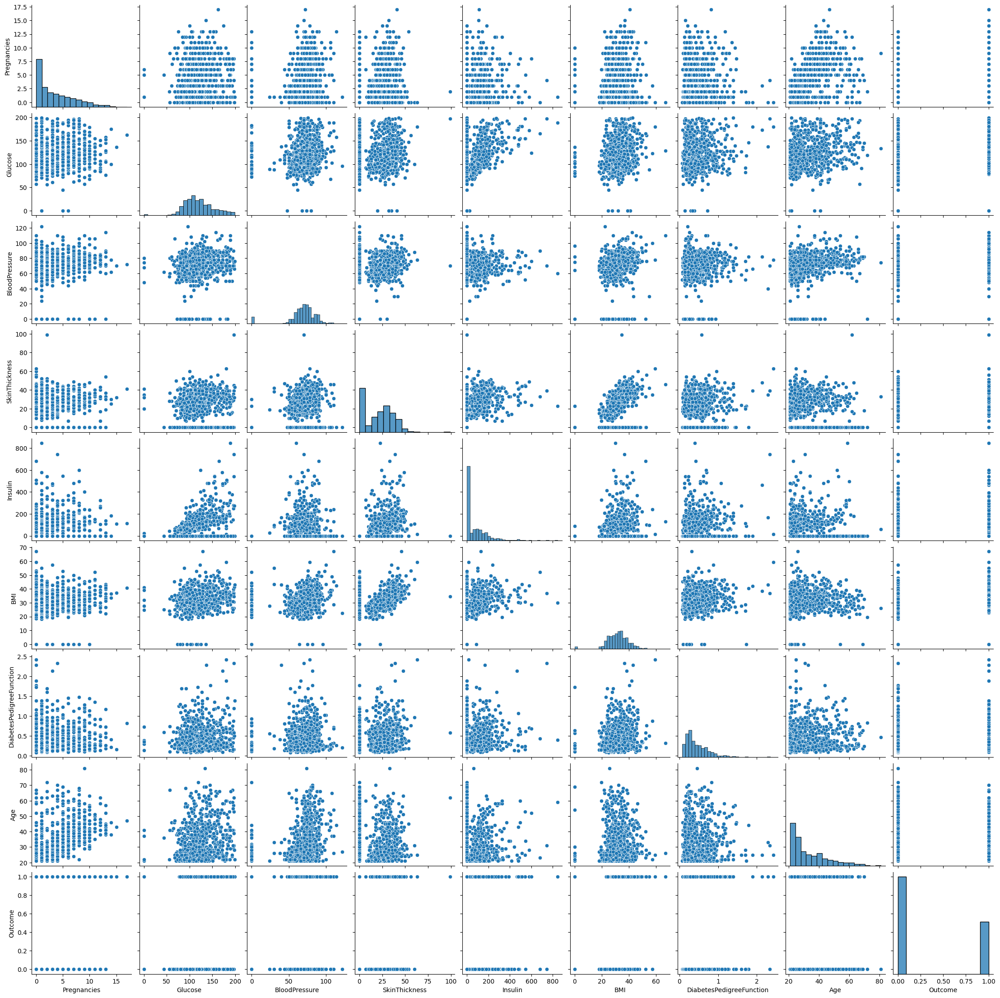

In [32]:
import seaborn as sns

sns.pairplot(data)

In [ ]:
# Descriptive Analysis
# Summary statistics for each column 
data.describe().T

,count,mean,std,min,25%,50%,75%,max
Pregnancies,768.0,3.845052,3.369578,0.000,1.00000,3.0000,6.00000,17.00
Glucose,768.0,120.894531,31.972618,0.000,99.00000,117.0000,140.25000,199.00
BloodPressure,768.0,69.105469,19.355807,0.000,62.00000,72.0000,80.00000,122.00
SkinThickness,768.0,20.536458,15.952218,0.000,0.00000,23.0000,32.00000,99.00
Insulin,768.0,79.799479,115.244002,0.000,0.00000,30.5000,127.25000,846.00
BMI,768.0,31.992578,7.884160,0.000,27.30000,32.0000,36.60000,67.10
DiabetesPedigreeFunction,768.0,0.471876,0.331329,0.078,0.24375,0.3725,0.62625,2.42
Age,768.0,33.240885,11.760232,21.000,24.00000,29.0000,41.00000,81.00
Outcome,768.0,0.348958,0.476951,0.000,0.00000,0.0000,1.00000,1.00


The analysis of irregularities that indicate unrealistic or potentially incorrect values in some columns:
 - Glucose: 
Min = 0, a glucose level of 0 is physiologically impossible and this likely represents missing data or incorrectly recorded values.

 - BloodPressure:
A blood pressure of 0 is not possible in a living person.

- SkinThickness:
A skinfold thickness of 0 and 25% (Q1) = 0 are unrealistic.

- Insulin:
Impossible to have 0 insulin in the human body. 
Max = 846 is Very high, possibly an outlier.

- BMI (Body Mass Index):
BMI cannot be 0, so this is invalid.

 2- Data Exploration with ydata-profiling

In [ ]:
from ydata_profiling import ProfileReport

# Generate the profile report
raw_profile = ProfileReport(
    data, 
    title='Diabetes Raw Dataset Profiling Report',
    explorative=True  # adds more interactivity and detail
)

# Save to HTML file (so you can open it in browser)
raw_profile.to_file("diabetes_raw_profiling_report.html")

# display directly in Jupyter Notebook
raw_profile.to_notebook_iframe()


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 9/9 [00:00<00:00, 40.71it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

    Diabetes Dataset Analysis 

Upon reviewing the profiling report, several key observations emerge regarding missing values, correlations, and distribution patterns:

- Missing Values in Key Columns

Glucose: 0.7% of entries are zero, which is physiologically implausible. These are treated as missing values during cleaning.

Insulin: 48.7% of entries are zero, indicating significant missingness likely due to measurement challenges. This feature may require imputation or exclusion depending on modeling goals.

BMI: 1.4% of entries are zero,small but significant, especially for metabolic risk analysis. Likely cleaned or imputed in the processed dataset.


- Correlation Insights

Glucose vs Outcome: Shows a strong positive correlation (≈ 0.487), suggesting that higher glucose levels are strongly associated with diabetes diagnosis. glucose is a key predictor of diabetes.

Age vs Outcome: Moderate correlation (≈ 0.314), indicating that older individuals may be at higher risk.

Age vs Glucose: Mild correlation (≈ 0.285), implying a slight trend of increasing glucose with age.

- Notable Patterns

Glucose Distribution: Right-skewed with a wide range (0–199), highlighting outliers and potential diabetic cases.

Blood Pressure and BMI: Both contain zero values in the raw dataset, which are likely cleaned due to physiological implausibility.

Age Range: Spans from 21 to 81, with risk increasing in older age groups.




    Suggestions


The cleaned dataset improves data integrity by addressing biologically invalid values. Glucose emerges as the most predictive feature, while age and BMI provide valuable secondary signals. Insulin’s high missing rate warrants cautious use. These insights guide feature selection and preprocessing for reliable modeling.

In [35]:
# Create a copy of the original DataFrame for comparison
data_c = data.copy(deep= True)

In [36]:
# Replace all zero values in the 'Pregnancies' column with the column's median value
data_c['Pregnancies'] = data_c['Pregnancies'].replace(0,data_c['Pregnancies'].median())

In [37]:
import numpy as np
import pandas as pd
from sklearn.impute import KNNImputer

# remplace 0 with NaN
cols_with_zeros = ["Glucose", "BloodPressure", "SkinThickness", "Insulin", "BMI"]
data_c[cols_with_zeros] = data_c[cols_with_zeros].replace(0, np.nan)

# Apply KNN Imputer
imputer = KNNImputer(n_neighbors=5)
data_c = pd.DataFrame(imputer.fit_transform(data_c), columns=data_c.columns)



In [38]:
data_c.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 768 entries, 0 to 767
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Pregnancies               768 non-null    float64
 1   Glucose                   768 non-null    float64
 2   BloodPressure             768 non-null    float64
 3   SkinThickness             768 non-null    float64
 4   Insulin                   768 non-null    float64
 5   BMI                       768 non-null    float64
 6   DiabetesPedigreeFunction  768 non-null    float64
 7   Age                       768 non-null    float64
 8   Outcome                   768 non-null    float64
dtypes: float64(9)
memory usage: 54.1 KB


In [39]:
# Check if NaNs are gone
print("Remaining NaNs per column:")
print(data_c.isna().sum())

Remaining NaNs per column:
Pregnancies                 0
Glucose                     0
BloodPressure               0
SkinThickness               0
Insulin                     0
BMI                         0
DiabetesPedigreeFunction    0
Age                         0
Outcome                     0
dtype: int64


In [47]:
#Sample of imputed Glucose values
print(f"Sample of imputed Glucose values: {data_c['Glucose'].head(10)}") 

Sample of imputed Glucose values: 0    148.0
1     85.0
2    183.0
3     89.0
4    137.0
5    116.0
6     78.0
7    115.0
8    197.0
9    125.0
Name: Glucose, dtype: float64


In [ ]:
data_c.head(10)

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6.0,148.0,72.0,35.0,169.0,33.60,0.627,50.0,1.0
1,1.0,85.0,66.0,29.0,58.6,26.60,0.351,31.0,0.0
2,8.0,183.0,64.0,25.8,164.6,23.30,0.672,32.0,1.0
3,1.0,89.0,66.0,23.0,94.0,28.10,0.167,21.0,0.0
4,3.0,137.0,40.0,35.0,168.0,43.10,2.288,33.0,1.0
5,5.0,116.0,74.0,20.6,98.0,25.60,0.201,30.0,0.0
6,3.0,78.0,50.0,32.0,88.0,31.00,0.248,26.0,1.0
7,10.0,115.0,77.6,34.4,132.6,35.30,0.134,29.0,0.0
8,2.0,197.0,70.0,45.0,543.0,30.50,0.158,53.0,1.0
9,8.0,125.0,96.0,26.4,165.8,34.92,0.232,54.0,1.0


In [ ]:
# Descriptive Analysis for the cleaned data 
data_c.describe().T

,count,mean,std,min,25%,50%,75%,max
Pregnancies,768.0,4.278646,3.021516,1.000,2.00000,3.0000,6.00000,17.00
Glucose,768.0,121.596875,30.497539,44.000,99.00000,117.0000,140.25000,199.00
BloodPressure,768.0,72.378125,12.192529,24.000,64.00000,72.0000,80.00000,122.00
SkinThickness,768.0,29.094271,9.414952,7.000,23.00000,29.0000,35.00000,99.00
Insulin,768.0,153.229427,98.166506,14.000,87.95000,134.6000,190.70000,846.00
BMI,768.0,32.431250,6.886491,18.200,27.50000,32.1400,36.60000,67.10
DiabetesPedigreeFunction,768.0,0.471876,0.331329,0.078,0.24375,0.3725,0.62625,2.42
Age,768.0,33.240885,11.760232,21.000,24.00000,29.0000,41.00000,81.00
Outcome,768.0,0.348958,0.476951,0.000,0.00000,0.0000,1.00000,1.00


In [48]:
from ydata_profiling import ProfileReport
# Generate the profile report
profile = ProfileReport(
    data_c, 
    title='Diabetes Dataset Cleaned Profiling Report',
    explorative=True  # adds more interactivity and detail
)

# Save to HTML file (so you can open it in browser)
profile.to_file("diabetes_cleaned_profiling_report.html")

# display directly in Jupyter Notebook
profile.to_notebook_iframe()


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 9/9 [00:00<00:00, 23.50it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [49]:
comp_report = raw_profile.compare(profile)
comp_report

# Save to HTML file (so you can open it in browser)
comp_report.to_file("Comparative_diabetes_profiling_report.html")

# display directly in Jupyter Notebook
comp_report.to_notebook_iframe()

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]